In [344]:
import pandas as pd
import numpy as np
import urllib.request
import zipfile
import random
import itertools
import math
import datetime

import sklearn 
import shapefile
from shapely.geometry import Polygon
from descartes.patch import PolygonPatch
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline

In [345]:
def get_lat_lon(sf):
    content = []
    for sr in sf.shapeRecords():
        shape = sr.shape
        rec = sr.record
        loc_id = rec[shp_dic['LocationID']]
        
        x = (shape.bbox[0]+shape.bbox[2])/2
        y = (shape.bbox[1]+shape.bbox[3])/2
        
        content.append((loc_id, x, y))
    return pd.DataFrame(content, columns=["LocationID", "longitude", "latitude"])

In [346]:
def draw_region_map(ax, sf, heat={}):
    continent = [235/256, 151/256, 78/256]
    ocean = (89/256, 171/256, 227/256)    
    
    reg_list={'Staten Island':1, 'Queens':2, 'Bronx':3, 'Manhattan':4, 'EWR':5, 'Brooklyn':6}
    reg_x = {'Staten Island':[], 'Queens':[], 'Bronx':[], 'Manhattan':[], 'EWR':[], 'Brooklyn':[]}
    reg_y = {'Staten Island':[], 'Queens':[], 'Bronx':[], 'Manhattan':[], 'EWR':[], 'Brooklyn':[]}
    
    # colorbar
    if len(heat) != 0:
        norm = mpl.colors.Normalize(vmin=math.sqrt(min(heat.values())), vmax=math.sqrt(max(heat.values()))) #norm = mpl.colors.LogNorm(vmin=1,vmax=max(heat))
        cm=plt.get_cmap('Reds')
        #sm = plt.cm.ScalarMappable(cmap=cm, norm=norm)
        #sm.set_array([])
        #plt.colorbar(sm, ticks=np.linspace(min(heat.values()),max(heat.values()),8), \
        #             boundaries=np.arange(min(heat.values())-10,max(heat.values())+10,.1))
    
    ax.set_facecolor(ocean)
    for sr in sf.shapeRecords():
        shape = sr.shape
        rec = sr.record
        reg_name = rec[shp_dic['borough']]
        
        if len(heat) == 0:
            norm = mpl.colors.Normalize(vmin=1,vmax=6) #norm = mpl.colors.LogNorm(vmin=1,vmax=max(heat))
            cm=plt.get_cmap('Pastel1')
            R,G,B,A = cm(norm(reg_list[reg_name]))
            col = [R,G,B]
        else:
            R,G,B,A = cm(norm(math.sqrt(heat[reg_name])))
            col = [R,G,B]
            
        # check number of parts (could use MultiPolygon class of shapely?)
        nparts = len(shape.parts) # total parts
        if nparts == 1:
            polygon = Polygon(shape.points)
            patch = PolygonPatch(polygon, facecolor=col, alpha=1.0, zorder=2)
            ax.add_patch(patch)
        else: # loop over parts of each shape, plot separately
            for ip in range(nparts): # loop over parts, plot separately
                i0 = shape.parts[ip]
                if ip < nparts-1:
                    i1 = shape.parts[ip+1]-1
                else:
                    i1 = len(shape.points)

                polygon = Polygon(shape.points[i0:i1+1])
                patch = PolygonPatch(polygon, facecolor=col, alpha=1.0, zorder=2)
                ax.add_patch(patch)
                
        reg_x[reg_name].append((shape.bbox[0]+shape.bbox[2])/2)
        reg_y[reg_name].append((shape.bbox[1]+shape.bbox[3])/2)
        
    for k in reg_list:
        if len(heat)==0:
            plt.text(np.mean(reg_x[k]), np.mean(reg_y[k]), k, horizontalalignment='center', verticalalignment='center',
                        bbox=dict(facecolor='black', alpha=0.5), color="white", fontsize=12)     
        else:
            plt.text(np.mean(reg_x[k]), np.mean(reg_y[k]), "{}\n({}K)".format(k, heat[k]/1000), horizontalalignment='center', 
                     verticalalignment='center',bbox=dict(facecolor='black', alpha=0.5), color="white", fontsize=12)       

    # display
    limits = get_boundaries(sf)
    plt.xlim(limits[0], limits[1])
    plt.ylim(limits[2], limits[3])


In [440]:
def draw_zone_map(ax, sf, location, pointtext = 'Yankee Stadium', heat={}, text=[], arrows=[], heatcolor = "Blues"):
    continent = [235/256, 151/256, 78/256]
    ocean = (89/256, 171/256, 227/256)
    grey = (220/256,220/256,220/256)
    theta = np.linspace(0, 2*np.pi, len(text)+1).tolist()
    ax.set_facecolor(grey)

    reg_list={'Staten Island':1, 'Queens':2, 'Bronx':3, 'Manhattan':4, 'EWR':5, 'Brooklyn':6}
    reg_x = {'Staten Island':[], 'Queens':[], 'Bronx':[], 'Manhattan':[], 'EWR':[], 'Brooklyn':[]}
    reg_y = {'Staten Island':[], 'Queens':[], 'Bronx':[], 'Manhattan':[], 'EWR':[], 'Brooklyn':[]}

    # colorbar
    if len(heat) != 0:
        norm = mpl.colors.Normalize(vmin=min(heat.values()),vmax=max(heat.values())) 
        #norm = mpl.colors.LogNorm(vmin=1,vmax=max(heat.values()))
        #norm = mpl.colors.LogNorm(vmin=min(heat.values(), vmax=max(heat.values()))
        #print(norm, max(heat.values()))
        cm=plt.get_cmap(heatcolor)
        sm = plt.cm.ScalarMappable(cmap=cm, norm=norm)
        sm.set_array([])
        #plt.colorbar(sm, ticks=np.linspace(min(heat.values()),max(heat.values()),8),
                     #boundaries=np.arange(min(heat.values())-10,max(heat.values())+10,.1))
        #plt.colorbar(sm, ticks=np.linspace(min(heat.values()) / max(heat.values()),max(heat.values()) / max(heat.values()),8),
                     #boundaries=np.arange(min(heat.values())-10,max(heat.values())+10,.1))
    
    for sr in sf.shapeRecords():
        shape = sr.shape
        rec = sr.record
        loc_id = rec[shp_dic['LocationID']]
        zone = rec[shp_dic['zone']]
        reg_name = rec[shp_dic['borough']]

        if len(heat) == 0:
            col = continent
        else:
            if loc_id not in heat:
                R,G,B,A = cm(norm(0))
            else:
                R,G,B,A = cm(norm(heat[loc_id]))
            col = [R,G,B]

        # check number of parts (could use MultiPolygon class of shapely?)
        nparts = len(shape.parts) # total parts
        if nparts == 1:
            polygon = Polygon(shape.points)
            patch = PolygonPatch(polygon, facecolor=col, alpha=1.0, zorder=2, edgecolor = 'Black')
            ax.add_patch(patch)
        else: # loop over parts of each shape, plot separately
            for ip in range(nparts): # loop over parts, plot separately
                i0 = shape.parts[ip]
                if ip < nparts-1:
                    i1 = shape.parts[ip+1]-1
                else:
                    i1 = len(shape.points)

                polygon = Polygon(shape.points[i0:i1+1])
                patch = PolygonPatch(polygon, facecolor=col, alpha=1, zorder=2, edgecolor = 'Black')
                ax.add_patch(patch)
        
        x = (shape.bbox[0]+shape.bbox[2])/2
        y = (shape.bbox[1]+shape.bbox[3])/2

        reg_x[reg_name].append((shape.bbox[0]+shape.bbox[2])/2)
        reg_y[reg_name].append((shape.bbox[1]+shape.bbox[3])/2)
        #if (len(text) == 0 and rec[shp_dic['Shape_Area']] > 0.0001):
            #plt.text(x, y, str(loc_id), horizontalalignment='center', verticalalignment='center')            
        #elif len(text) != 0 and loc_id in text:
        if len(text) != 0 and loc_id in text:
            #plt.text(x+0.01, y-0.01, str(loc_id), fontsize=12, color="white", bbox=dict(facecolor='black', alpha=0.5))
            eta_x = 0.05*np.cos(theta[text.index(loc_id)])
            eta_y = 0.05*np.sin(theta[text.index(loc_id)])
            ax.annotate("[{}] {}".format(loc_id, zone), xy=(x, y), xytext=(x+eta_x, y+eta_y),
                        bbox=dict(facecolor='grey', alpha=0.5), color="white", fontsize=12,
                        arrowprops=dict(facecolor='black', width=3, shrink=0.05))
        
    if len(arrows)!=0:
        for arr in arrows:
            ax.annotate('', xy = arr['dest'], xytext = arr['src'], size = arr['cnt'], arrowprops=dict(arrowstyle="fancy", fc="0.4", ec="none"))
    
    for k in reg_list:
        plt.text(np.mean(reg_x[k]), np.mean(reg_y[k]) + .012, k, horizontalalignment='center', verticalalignment='center',
                    bbox=dict(facecolor='black', alpha=0.5), color="white", fontsize=12)     
 

    # display
    #plt.plot(zorder = 5, marker = 'P', color = 'yellow')
    plt.plot(location[0], location[1], zorder = 5, marker = 'P', color = 'yellow')
    plt.text(location[0], location[1] + .007, pointtext, horizontalalignment='center', verticalalignment='center',
                    bbox=dict(facecolor='black', alpha=0.5), color="white", fontsize=12)
    limits = get_boundaries(sf)


    plt.xlim(limits[0], limits[1])
    plt.ylim(limits[2], limits[3])


In [348]:
def get_boundaries(sf):
    lat, lon = [], []
    for shape in list(sf.iterShapes()):
        lat.extend([shape.bbox[0], shape.bbox[2]])
        lon.extend([shape.bbox[1], shape.bbox[3]])

    margin = 0.01 # buffer to add to the range
    lat_min = min(lat) - margin
    lat_max = max(lat) + margin
    lon_min = min(lon) - margin
    lon_max = max(lon) + margin

    return lat_min, lat_max, lon_min, lon_max

In [349]:
sf = shapefile.Reader("data/taxi_zones.shp")
fields_name = [field[0] for field in sf.fields[1:]]
shp_dic = dict(zip(fields_name, list(range(len(fields_name)))))
attributes = sf.records()
shp_attr = [dict(zip(fields_name, attr)) for attr in attributes]

df_loc = pd.DataFrame(shp_attr).join(get_lat_lon(sf).set_index("LocationID"), on="LocationID")
df_loc.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,longitude,latitude
0,1,0.116357,0.000782,Newark Airport,1,EWR,-74.171533,40.689483
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,-73.822478,40.610824
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,-73.844953,40.865747
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,-73.977725,40.724137
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,-74.187558,40.550664


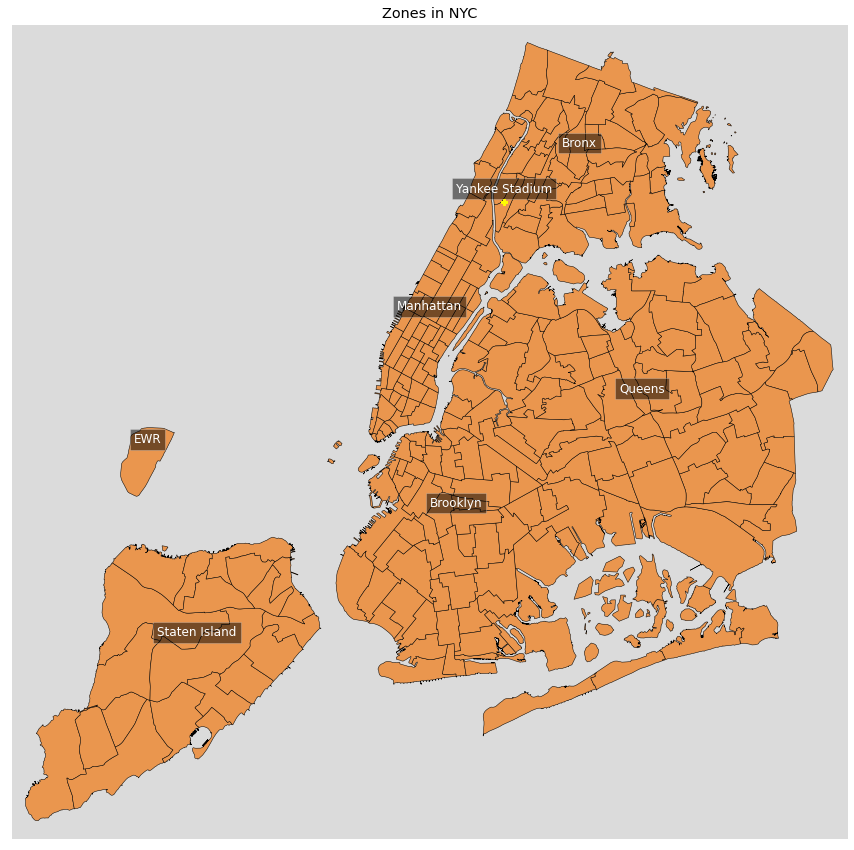

In [350]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,15))
ax = plt.subplot(1, 1, 1)
ax.set_title("Zones in NYC")

draw_zone_map(ax, sf, location = (-73.9262, 40.8296))

ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
plt.show()

In [351]:
df_longitude = df_loc[['LocationID', 'longitude']].set_index('LocationID')
df_latitude = df_loc[['LocationID', 'latitude']].set_index('LocationID')
longitude_dict = df_longitude.T.to_dict('record')[0]
latitude_dict = df_latitude.T.to_dict('record')[0]

<ipython-input-351-7d1071a88b9a>:3: UserWarning: DataFrame columns are not unique, some columns will be omitted.
  longitude_dict = df_longitude.T.to_dict('record')[0]
C:\Users\davek\Anaconda3\envs\CovidSentiment\lib\site-packages\pandas\core\frame.py:1549: FutureWarning: Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.
  warnings.warn(
<ipython-input-351-7d1071a88b9a>:4: UserWarning: DataFrame columns are not unique, some columns will be omitted.
  latitude_dict = df_latitude.T.to_dict('record')[0]


In [352]:
import sqlalchemy as db

nyc_database = db.create_engine('sqlite:///nyc_database.db')

In [353]:
connection = nyc_database.connect()
metadata = db.MetaData()
data = db.Table('table_record', metadata, autoload = True, autoload_with = nyc_database)

print(data.columns.keys())
print('\n')
print(repr(metadata.tables['table_record']))

['index', 'VendorID', 'passenger_count', 'trip_distance', 'RatecodeID', 'store_and_fwd_flag', 'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount', 'total_amount', 'congestion_surcharge', 'pickup_datetime', 'dropoff_datetime']


Table('table_record', MetaData(), Column('index', BIGINT(), table=<table_record>), Column('VendorID', BIGINT(), table=<table_record>), Column('passenger_count', BIGINT(), table=<table_record>), Column('trip_distance', FLOAT(), table=<table_record>), Column('RatecodeID', BIGINT(), table=<table_record>), Column('store_and_fwd_flag', TEXT(), table=<table_record>), Column('PULocationID', BIGINT(), table=<table_record>), Column('DOLocationID', BIGINT(), table=<table_record>), Column('payment_type', BIGINT(), table=<table_record>), Column('fare_amount', FLOAT(), table=<table_record>), Column('extra', FLOAT(), table=<table_record>), Column('mta_tax', FLOAT(), table=<table_record>), Column('tip_amount', FLOAT()

In [354]:
#Yankee and Mets Game Schedule

colnames = ['Date', 'Doubleheader', 'DayOfWeek', 'VisitingTeam', 'LeagueVisit', 'SeasonGameVisit', 'HomeTeam', 'LeagueHome', 'SeasonGameHome', 'Time', 'Postponement', 'MakeupDate']
mlb_df = pd.read_csv('data/2019SKED.txt', names = colnames, na_values = '')
mlb_df = mlb_df.where(pd.notnull(mlb_df), None)
	
mlb_df['Date'] = pd.to_datetime(mlb_df['Date'], format = '%Y%m%d') #20190401 example data

In [355]:
YanksHomeGames = mlb_df[(mlb_df['HomeTeam'] == 'NYA') & (mlb_df['Time'] == 'n') & (mlb_df['MakeupDate'].values == None)]
YanksAwayGames = mlb_df[(mlb_df['VisitingTeam'] == 'NYA') & (mlb_df['Time'] == 'n') & (mlb_df['MakeupDate'].values == None)]

MetsHomeGames = mlb_df[(mlb_df['HomeTeam'] == 'NYN') & (mlb_df['Time'] == 'n') & (mlb_df['MakeupDate'].values == None)]
MetsAwayGames = mlb_df[(mlb_df['VisitingTeam'] == 'NYN') & (mlb_df['Time'] == 'n') & (mlb_df['MakeupDate'].values == None)]

print('Number of Yankee Home Night Games:', YanksHomeGames.shape[0], '\nNumber of Mets Home Night Games:', MetsHomeGames.shape[0])
print('Number of Yankee Away Night Games:', YanksAwayGames.shape[0], '\nNumber of Mets Away Night Games:', MetsAwayGames.shape[0])

YanksHomeGamesTup = tuple(YanksHomeGames['Date'])
YanksAwayGamesTup = tuple(YanksAwayGames['Date'])
MetsHomeGamesTup = tuple(MetsHomeGames['Date'])
MetsAwayGamesTup = tuple(MetsAwayGames['Date'])

Number of Yankee Home Night Games: 45 
Number of Mets Home Night Games: 58
Number of Yankee Away Night Games: 53 
Number of Mets Away Night Games: 50


In [356]:
df_head = pd.read_sql_query('SELECT * FROM table_record LIMIT 5', nyc_database)
df_head

,index,VendorID,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,total_amount,congestion_surcharge,pickup_datetime,dropoff_datetime
0,0,2,1,2.52,1,N,68,233,1,11.0,0.5,0.5,2.22,0.0,17.02,2.5,2019-08-14 00:48:46.000000,2019-08-14 01:02:02.000000
1,1,2,1,1.30,1,N,114,79,1,7.5,0.5,0.5,2.26,0.0,13.56,2.5,2019-08-14 00:05:19.000000,2019-08-14 00:15:15.000000
2,2,2,4,13.05,1,N,132,252,2,35.5,0.5,0.5,0.00,0.0,36.80,0.0,2019-08-14 00:41:47.000000,2019-08-14 01:00:33.000000
3,3,1,1,18.20,2,N,132,142,1,52.0,2.5,0.5,0.00,0.0,55.30,2.5,2019-08-14 00:08:16.000000,2019-08-14 00:39:38.000000
4,4,1,1,4.30,1,N,68,262,4,14.5,3.0,0.5,0.00,0.0,18.30,2.5,2019-08-14 00:50:10.000000,2019-08-14 01:04:38.000000


In [357]:
df_yanks = pd.read_sql_query('SELECT PULocationID, DOLocationID, pickup_datetime, dropoff_datetime FROM table_record WHERE PULocationID = 247 OR PULocationID = 119', nyc_database)


In [358]:
df_yanks['pickup_datetime'] = pd.to_datetime(df_yanks['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
df_yanks['dropoff_datetime'] = pd.to_datetime(df_yanks['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df_yanks

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime
0,247,212,2019-08-14 01:25:08,2019-08-14 01:45:54
1,247,42,2019-08-14 01:53:58,2019-08-14 01:57:59
2,119,100,2019-08-14 02:24:06,2019-08-14 02:47:39
3,247,20,2019-08-14 03:39:59,2019-08-14 03:52:44
4,119,136,2019-08-14 05:09:38,2019-08-14 05:18:16
...,...,...,...,...
56460,247,159,2019-12-31 16:24:00,2019-12-31 16:38:00
56461,119,60,2019-12-31 16:08:00,2019-12-31 16:30:00
56462,119,159,2019-12-31 16:21:00,2019-12-31 16:35:00
56463,247,213,2019-12-31 20:33:00,2019-12-31 20:48:00


In [460]:
def HeatMaps(df_loc, dates_1, dates_2, startmodifier = datetime.timedelta(hours = 0), endmodifier = datetime.timedelta(hours = 0)):
    
    df_1 = pd.DataFrame(columns = df_loc.columns)

    for date in dates_1:
        mask = (df_loc['pickup_datetime'] > date + startmodifier) & (df_loc['pickup_datetime'] < date + endmodifier)

        df_1 = df_1.append(df_loc[mask], ignore_index=True)
    
    df_2 = pd.DataFrame(columns = df_loc.columns)

    for date in dates_2:
        mask = (df_loc['pickup_datetime'] > date + startmodifier) & (df_loc['pickup_datetime'] < date + endmodifier)

        df_2 = df_2.append(df_loc[mask], ignore_index=True)

    HeatMap1 = df_1[['DOLocationID', 'PULocationID']].groupby('DOLocationID').count()
    one_Dict = HeatMap1.T.to_dict('records')
    one_Dict = one_Dict[0]

    HeatMap2 = df_2[['DOLocationID', 'PULocationID']].groupby('DOLocationID').count()
    two_Dict = HeatMap2.T.to_dict('records')
    two_Dict = two_Dict[0]

    return(one_Dict, two_Dict)

In [459]:
YanksHomeHeatMap, YanksAwayHeatMap = HeatMaps(df_yanks, YanksHomeGamesTup, YanksAwayGamesTup, startmodifier = datetime.timedelta(hours = 20), endmodifier = datetime.timedelta(hours = 24))

{3: 1, 4: 13, 7: 38, 9: 3, 10: 1, 13: 16, 14: 5, 15: 1, 16: 3, 17: 3, 18: 20, 19: 1, 20: 15, 24: 17, 25: 3, 28: 22, 29: 1, 31: 3, 32: 4, 33: 12, 35: 1, 36: 4, 37: 7, 40: 5, 41: 60, 42: 138, 43: 17, 45: 3, 46: 5, 47: 23, 48: 76, 49: 7, 50: 25, 51: 6, 52: 2, 53: 1, 54: 2, 56: 1, 58: 3, 60: 9, 61: 5, 62: 1, 64: 1, 65: 3, 66: 3, 67: 1, 68: 28, 69: 64, 70: 4, 71: 1, 72: 2, 74: 83, 75: 48, 76: 1, 77: 1, 78: 10, 79: 33, 80: 5, 81: 10, 82: 7, 83: 2, 87: 6, 88: 2, 89: 2, 90: 15, 91: 4, 93: 1, 94: 5, 95: 13, 97: 1, 100: 32, 102: 1, 107: 12, 112: 8, 113: 7, 114: 7, 116: 77, 117: 1, 119: 116, 120: 9, 123: 2, 124: 2, 125: 3, 126: 8, 127: 53, 129: 6, 130: 5, 132: 5, 133: 3, 134: 2, 136: 14, 137: 31, 139: 1, 140: 26, 141: 43, 142: 28, 143: 21, 144: 6, 145: 8, 146: 4, 147: 18, 148: 17, 151: 20, 152: 26, 153: 3, 157: 1, 158: 13, 159: 54, 160: 2, 161: 58, 162: 41, 163: 31, 164: 40, 166: 50, 167: 35, 168: 121, 169: 35, 170: 38, 171: 4, 173: 2, 174: 11, 179: 25, 180: 1, 181: 14, 182: 12, 183: 6, 184: 1, 1

<ipython-input-445-c54b89927973>:8: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig('YanksHome.jpg', bbox = 'tight')


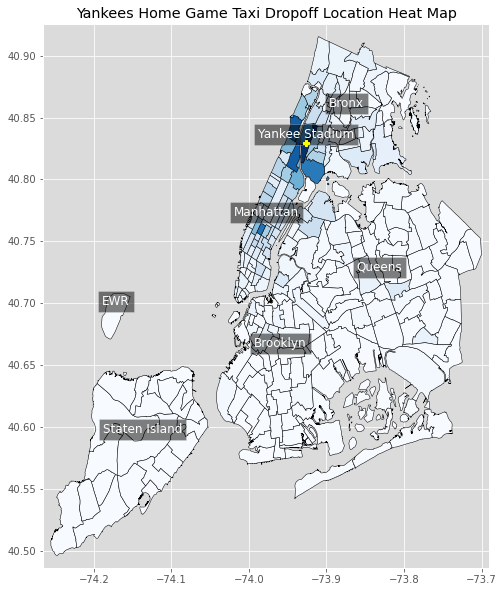

In [445]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Yankees Home Game Taxi Dropoff Location Heat Map")

draw_zone_map(ax, sf, location = (-73.9262, 40.8296), heat = YanksHomeHeatMap, heatcolor='Blues')


plt.savefig('YanksHome.jpg', bbox = 'tight')
plt.show()

<ipython-input-450-ec357c0d5d2a>:7: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig('YanksAway.jpg', bbox = 'tight')


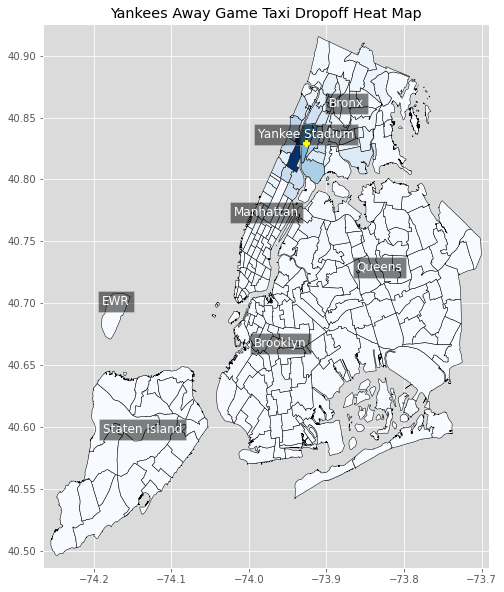

In [450]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Yankees Away Game Taxi Dropoff Heat Map")

draw_zone_map(ax, sf, location = (-73.9262, 40.8296), heat = YanksAwayHeatMap, heatcolor='Blues')
ax.plot(-73.9262, 40.8296, zorder = 3)
plt.savefig('YanksAway.jpg', bbox = 'tight')
plt.show()

In [363]:
df_mets = pd.read_sql_query('SELECT PULocationID, DOLocationID, pickup_datetime, dropoff_datetime FROM table_record WHERE PULocationID = 93 OR PULocationID = 253', nyc_database)


In [364]:
df_mets['pickup_datetime'] = pd.to_datetime(df_mets['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
df_mets['dropoff_datetime'] = pd.to_datetime(df_mets['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df_mets

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime
0,93,231,2019-08-14 00:15:28,2019-08-14 00:35:04
1,93,186,2019-08-14 01:09:31,2019-08-14 01:25:43
2,93,234,2019-08-14 05:52:45,2019-08-14 06:11:51
3,93,93,2019-08-14 05:18:06,2019-08-14 05:19:30
4,93,211,2019-08-14 05:59:30,2019-08-14 06:23:04
...,...,...,...,...
40984,253,55,2019-12-27 14:23:00,2019-12-27 15:30:00
40985,93,93,2019-12-29 13:22:00,2019-12-29 13:23:00
40986,93,116,2019-12-30 08:15:00,2019-12-30 08:39:00
40987,93,28,2019-12-30 14:46:00,2019-12-30 15:01:00


In [365]:
MetsHomeHeatMap, MetsAwayHeatMap = HeatMaps(df_mets, MetsHomeGamesTup, MetsAwayGamesTup, startmodifier = datetime.timedelta(hours = 20), endmodifier = datetime.timedelta(hours = 24))

<ipython-input-444-3051a5ebd10e>:6: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig('MetsHome.jpg', bbox = 'tight')


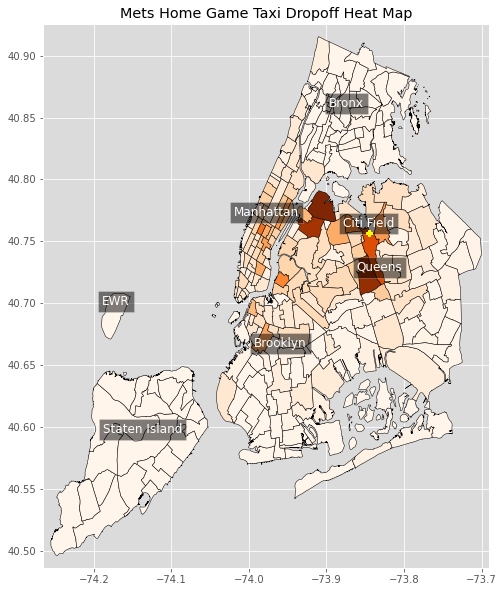

In [444]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Mets Home Game Taxi Dropoff Heat Map")

draw_zone_map(ax, sf, location = (-73.8458, 40.7571), heat = MetsHomeHeatMap, heatcolor='Oranges', pointtext = 'Citi Field')
plt.savefig('MetsHome.jpg', bbox = 'tight')
plt.show()

<ipython-input-443-59cbc568caf4>:6: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig('MetsAway.jpg', bbox = 'tight')


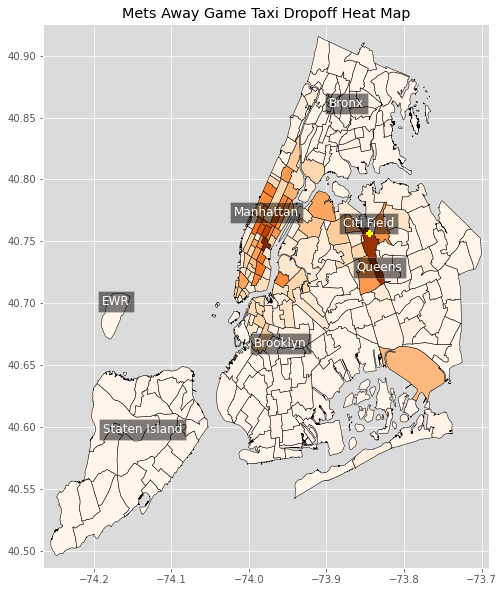

In [443]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Mets Away Game Taxi Dropoff Heat Map")

draw_zone_map(ax, sf, location = (-73.8458, 40.7571), heat = MetsAwayHeatMap, heatcolor='Oranges', pointtext = 'Citi Field')
plt.savefig('MetsAway.jpg', bbox = 'tight')
plt.show()

In [368]:
#Build a model to determine if traffic is normal or not.  


#SQL Database
#['index', 'VendorID', 'passenger_count', 'trip_distance', 'RatecodeID', 'store_and_fwd_flag', 'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount', 'total_amount', 'congestion_surcharge', 'pickup_datetime', 'dropoff_datetime']
#yanks query
df_yanks_model = pd.read_sql_query('SELECT PULocationID, DOLocationID, pickup_datetime, dropoff_datetime, passenger_count, \
                                trip_distance, RatecodeID, payment_type, fare_amount, tip_amount \
                                FROM table_record \
                                WHERE PULocationID = 247 OR PULocationID = 119', nyc_database)

In [369]:
df_yanks_model

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,RatecodeID,payment_type,fare_amount,tip_amount
0,247,212,2019-08-14 01:25:08.000000,2019-08-14 01:45:54.000000,1.0,7.19,5.0,2.0,18.00,0.0
1,247,42,2019-08-14 01:53:58.000000,2019-08-14 01:57:59.000000,3.0,0.52,1.0,1.0,5.00,0.0
2,119,100,2019-08-14 02:24:06.000000,2019-08-14 02:47:39.000000,1.0,11.01,1.0,2.0,32.00,0.0
3,247,20,2019-08-14 03:39:59.000000,2019-08-14 03:52:44.000000,1.0,2.60,1.0,2.0,11.00,0.0
4,119,136,2019-08-14 05:09:38.000000,2019-08-14 05:18:16.000000,1.0,0.00,1.0,1.0,30.20,0.0
...,...,...,...,...,...,...,...,...,...,...
56460,247,159,2019-12-31 16:24:00.000000,2019-12-31 16:38:00.000000,NaN,0.67,NaN,NaN,14.55,0.0
56461,119,60,2019-12-31 16:08:00.000000,2019-12-31 16:30:00.000000,NaN,3.01,NaN,NaN,21.26,0.0
56462,119,159,2019-12-31 16:21:00.000000,2019-12-31 16:35:00.000000,NaN,1.77,NaN,NaN,14.55,0.0
56463,247,213,2019-12-31 20:33:00.000000,2019-12-31 20:48:00.000000,NaN,6.49,NaN,NaN,16.49,0.0


In [370]:
df_yanks_model['pickup_datetime'] = pd.to_datetime(df_yanks['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
df_yanks_model['dropoff_datetime'] = pd.to_datetime(df_yanks['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df_yanks_model

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,RatecodeID,payment_type,fare_amount,tip_amount
0,247,212,2019-08-14 01:25:08,2019-08-14 01:45:54,1.0,7.19,5.0,2.0,18.00,0.0
1,247,42,2019-08-14 01:53:58,2019-08-14 01:57:59,3.0,0.52,1.0,1.0,5.00,0.0
2,119,100,2019-08-14 02:24:06,2019-08-14 02:47:39,1.0,11.01,1.0,2.0,32.00,0.0
3,247,20,2019-08-14 03:39:59,2019-08-14 03:52:44,1.0,2.60,1.0,2.0,11.00,0.0
4,119,136,2019-08-14 05:09:38,2019-08-14 05:18:16,1.0,0.00,1.0,1.0,30.20,0.0
...,...,...,...,...,...,...,...,...,...,...
56460,247,159,2019-12-31 16:24:00,2019-12-31 16:38:00,NaN,0.67,NaN,NaN,14.55,0.0
56461,119,60,2019-12-31 16:08:00,2019-12-31 16:30:00,NaN,3.01,NaN,NaN,21.26,0.0
56462,119,159,2019-12-31 16:21:00,2019-12-31 16:35:00,NaN,1.77,NaN,NaN,14.55,0.0
56463,247,213,2019-12-31 20:33:00,2019-12-31 20:48:00,NaN,6.49,NaN,NaN,16.49,0.0


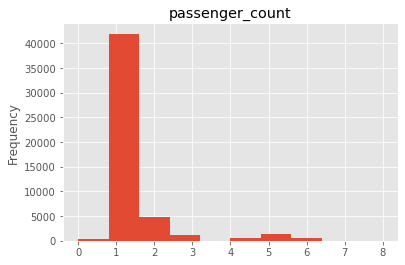

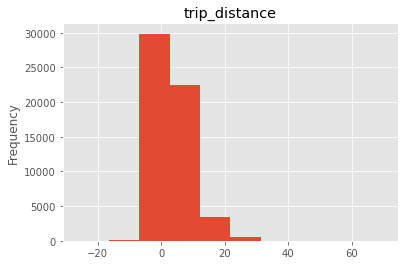

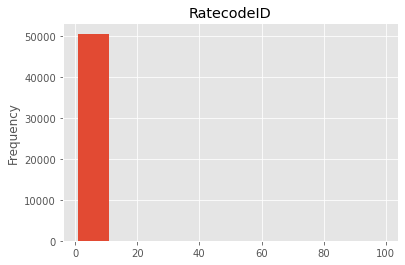

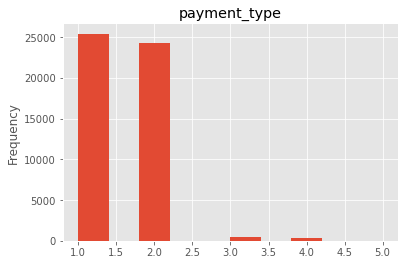

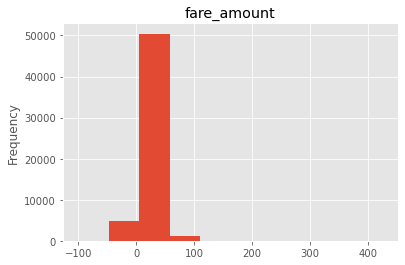

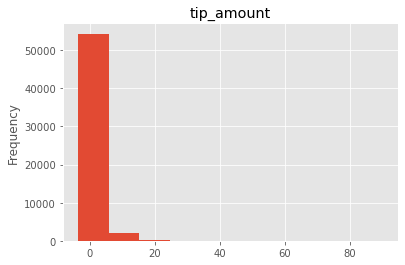

In [371]:
column_names = ['passenger_count','trip_distance','RatecodeID','payment_type','fare_amount','tip_amount']
for data in column_names:

    df_yanks_model[data].plot.hist()
    plt.title(data)
    plt.show()

In [372]:
df_yanks_model['passenger_count']= df_yanks_model['passenger_count'].fillna(1)
df_yanks_model['RatecodeID']= df_yanks_model['RatecodeID'].fillna(7)
df_yanks_model['payment_type']= df_yanks_model['payment_type'].fillna(5)

RateCodeDummies = pd.get_dummies(df_yanks_model['RatecodeID'], prefix = 'RateCode')
PaymentCodeDummies = pd.get_dummies(df_yanks_model['payment_type'], prefix = 'payment_type')

df_yankstrain = pd.concat([df_yanks_model, RateCodeDummies, PaymentCodeDummies], axis = 1)
df_yankstrain = df_yankstrain.drop(['RatecodeID', 'payment_type'], axis = 1)

df_yankstrain['Longitude'] = df_yankstrain['DOLocationID'].map(longitude_dict)
df_yankstrain['Latitude'] = df_yankstrain['DOLocationID'].map(latitude_dict)

df_yankstrain = df_yankstrain.dropna()

df_yankstrain

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_6.0,RateCode_7.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,247,212,2019-08-14 01:25:08,2019-08-14 01:45:54,1.0,7.19,18.00,0.0,0,0,...,0,0,0,0,1,0,0,0,-73.870401,40.828290
1,247,42,2019-08-14 01:53:58,2019-08-14 01:57:59,3.0,0.52,5.00,0.0,1,0,...,0,0,0,1,0,0,0,0,-73.942966,40.820965
2,119,100,2019-08-14 02:24:06,2019-08-14 02:47:39,1.0,11.01,32.00,0.0,1,0,...,0,0,0,0,1,0,0,0,-73.988791,40.753510
3,247,20,2019-08-14 03:39:59,2019-08-14 03:52:44,1.0,2.60,11.00,0.0,1,0,...,0,0,0,0,1,0,0,0,-73.886190,40.857739
4,119,136,2019-08-14 05:09:38,2019-08-14 05:18:16,1.0,0.00,30.20,0.0,1,0,...,0,0,0,1,0,0,0,0,-73.905394,40.865365
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56460,247,159,2019-12-31 16:24:00,2019-12-31 16:38:00,1.0,0.67,14.55,0.0,0,0,...,0,1,0,0,0,0,0,1,-73.913960,40.818335
56461,119,60,2019-12-31 16:08:00,2019-12-31 16:30:00,1.0,3.01,21.26,0.0,0,0,...,0,1,0,0,0,0,0,1,-73.884972,40.831336
56462,119,159,2019-12-31 16:21:00,2019-12-31 16:35:00,1.0,1.77,14.55,0.0,0,0,...,0,1,0,0,0,0,0,1,-73.913960,40.818335
56463,247,213,2019-12-31 20:33:00,2019-12-31 20:48:00,1.0,6.49,16.49,0.0,0,0,...,0,1,0,0,0,0,0,1,-73.860262,40.816712


In [373]:
df_yanksaway = pd.DataFrame(columns = df_yankstrain.columns)

for date in YanksAwayGamesTup:
    gamestart = datetime.timedelta(hours = 20)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_yankstrain['pickup_datetime'] > date + gamestart) & (df_yankstrain['pickup_datetime'] < date + gameend)

    df_yanksaway = df_yanksaway.append(df_yankstrain[mask], ignore_index=True)

df_yanksaway

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_6.0,RateCode_7.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,119,217,2019-04-06 20:32:41,2019-04-06 21:02:51,1.0,14.02,40.00,0.00,1,0,...,0,0,0,1,0,0,0,0,-73.957721,40.703233
1,247,152,2019-04-06 20:39:55,2019-04-06 21:00:38,1.0,2.72,15.00,0.00,1,0,...,0,0,0,1,0,0,0,0,-73.954055,40.817519
2,247,41,2019-04-06 21:40:56,2019-04-06 21:58:22,1.0,2.87,14.00,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.950709,40.804176
3,247,179,2019-04-06 22:01:59,2019-04-06 22:13:53,1.0,5.40,17.50,0.00,1,0,...,0,0,0,0,0,1,0,0,-73.927780,40.771421
4,119,69,2019-04-06 22:06:41,2019-04-06 22:17:51,2.0,2.27,10.00,0.00,1,0,...,0,0,0,1,0,0,0,0,-73.916166,40.830608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1082,247,51,2019-09-28 23:49:06,2019-09-29 00:23:39,1.0,9.75,32.50,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.829514,40.873436
1083,247,42,2019-09-28 23:37:04,2019-09-28 23:38:54,1.0,0.49,3.50,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.942966,40.820965
1084,247,244,2019-09-28 23:59:21,2019-09-29 00:11:22,2.0,1.65,10.00,1.11,1,0,...,0,0,0,1,0,0,0,0,-73.940774,40.841194
1085,119,47,2019-09-28 23:27:37,2019-09-28 23:47:47,2.0,2.62,13.50,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.900383,40.845317


In [374]:
df_yankshome = pd.DataFrame(columns = df_yankstrain.columns)

for date in YanksHomeGamesTup:
    gamestart = datetime.timedelta(hours = 20)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_yankstrain['pickup_datetime'] > date + gamestart) & (df_yankstrain['pickup_datetime'] < date + gameend)

    df_yankshome = df_yankshome.append(df_yankstrain[mask], ignore_index=True)

df_yankshome

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_6.0,RateCode_7.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,119,127,2019-04-01 20:52:22,2019-04-01 21:05:54,5.0,4.04,14.00,0.00,1,0,...,0,0,0,1,0,0,0,0,-73.919576,40.864459
1,247,81,2019-04-01 20:02:51,2019-04-01 20:22:35,1.0,11.19,32.00,0.00,1,0,...,0,0,0,1,0,0,0,0,-73.823321,40.877408
2,119,243,2019-04-01 21:42:22,2019-04-01 21:52:00,3.0,1.90,9.00,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.935798,40.858637
3,119,170,2019-04-01 21:58:04,2019-04-01 22:26:50,1.0,10.23,30.50,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.977648,40.747725
4,247,213,2019-04-01 21:35:44,2019-04-01 21:44:30,6.0,5.25,15.50,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.860262,40.816712
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3436,247,258,2019-09-20 23:37:59,2019-09-21 00:07:43,5.0,16.14,45.50,10.51,1,0,...,0,0,0,1,0,0,0,0,-73.854940,40.689977
3437,247,167,2019-09-20 23:48:12,2019-09-20 23:52:56,1.0,0.92,5.50,1.00,1,0,...,0,0,0,1,0,0,0,0,-73.901393,40.827988
3438,119,159,2019-09-20 21:46:00,2019-09-20 22:06:00,1.0,2.08,18.75,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.913960,40.818335
3439,119,72,2019-09-20 21:54:00,2019-09-20 22:33:00,1.0,19.44,64.13,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.920233,40.652655


In [375]:
df_yanksaway_model = df_yanksaway.drop(columns = ['PULocationID',	'DOLocationID',	'pickup_datetime','dropoff_datetime'], axis = 1)
df_yankshome_model = df_yankshome.drop(columns = ['PULocationID',	'DOLocationID',	'pickup_datetime','dropoff_datetime'], axis = 1)

In [376]:
from sklearn import preprocessing
yanksNormalizer = preprocessing.Normalizer().fit(df_yanksaway_model)

yanksNormTrain = yanksNormalizer.transform(df_yanksaway_model)
yanksNormTest = yanksNormalizer.transform(df_yankshome_model)

In [377]:
from sklearn.svm import OneClassSVM

SVM_model = OneClassSVM(kernel = 'linear', gamma='auto').fit(yanksNormTrain)
df_yankshome['Predict'] = SVM_model.predict(yanksNormTest)
df_YankTraffic = df_yankshome[df_yankshome['Predict'] == -1]
SVM_model.coef_

array([[ 7.98235467e+00,  2.44235207e+01,  9.59379678e+01,
         5.61747158e+00,  5.37169450e+00,  2.99966506e-02,
         0.00000000e+00,  0.00000000e+00,  3.06685284e-01,
         0.00000000e+00,  5.06043831e-01,  0.00000000e+00,
         2.28110085e+00,  3.19152473e+00,  9.46301744e-02,
         1.41120676e-01,  5.06043831e-01, -4.59419307e+02,
         2.53597895e+02]])

In [378]:
df_yanksaway_model

,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,RateCode_3.0,RateCode_4.0,RateCode_5.0,RateCode_6.0,RateCode_7.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,1.0,14.02,40.00,0.00,1,0,0,0,0,0,0,0,1,0,0,0,0,-73.957721,40.703233
1,1.0,2.72,15.00,0.00,1,0,0,0,0,0,0,0,1,0,0,0,0,-73.954055,40.817519
2,1.0,2.87,14.00,0.00,1,0,0,0,0,0,0,0,0,1,0,0,0,-73.950709,40.804176
3,1.0,5.40,17.50,0.00,1,0,0,0,0,0,0,0,0,0,1,0,0,-73.927780,40.771421
4,2.0,2.27,10.00,0.00,1,0,0,0,0,0,0,0,1,0,0,0,0,-73.916166,40.830608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1082,1.0,9.75,32.50,0.00,1,0,0,0,0,0,0,0,0,1,0,0,0,-73.829514,40.873436
1083,1.0,0.49,3.50,0.00,1,0,0,0,0,0,0,0,0,1,0,0,0,-73.942966,40.820965
1084,2.0,1.65,10.00,1.11,1,0,0,0,0,0,0,0,1,0,0,0,0,-73.940774,40.841194
1085,2.0,2.62,13.50,0.00,1,0,0,0,0,0,0,0,0,1,0,0,0,-73.900383,40.845317


In [379]:
df_YankTraffic

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_7.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude,Predict
1,247,81,2019-04-01 20:02:51,2019-04-01 20:22:35,1.0,11.19,32.00,0.00,1,0,...,0,0,1,0,0,0,0,-73.823321,40.877408,-1
3,119,170,2019-04-01 21:58:04,2019-04-01 22:26:50,1.0,10.23,30.50,0.00,1,0,...,0,0,0,1,0,0,0,-73.977648,40.747725,-1
5,247,234,2019-04-01 21:34:57,2019-04-01 21:58:12,2.0,8.70,27.00,0.00,1,0,...,0,0,0,1,0,0,0,-73.990457,40.740237,-1
8,119,238,2019-04-01 21:28:03,2019-04-01 21:45:03,1.0,7.91,24.00,5.56,1,0,...,0,0,1,0,0,0,0,-73.973031,40.791783,-1
10,247,171,2019-04-01 21:22:22,2019-04-01 21:47:47,1.0,12.60,36.50,5.00,1,0,...,0,0,1,0,0,0,0,-73.808445,40.768657,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3433,247,164,2019-09-20 23:37:19,2019-09-21 00:08:49,1.0,7.25,26.00,10.10,1,0,...,0,0,1,0,0,0,0,-73.985684,40.749083,-1
3436,247,258,2019-09-20 23:37:59,2019-09-21 00:07:43,5.0,16.14,45.50,10.51,1,0,...,0,0,1,0,0,0,0,-73.854940,40.689977,-1
3437,247,167,2019-09-20 23:48:12,2019-09-20 23:52:56,1.0,0.92,5.50,1.00,1,0,...,0,0,1,0,0,0,0,-73.901393,40.827988,-1
3439,119,72,2019-09-20 21:54:00,2019-09-20 22:33:00,1.0,19.44,64.13,0.00,0,0,...,1,0,0,0,0,0,1,-73.920233,40.652655,-1


In [380]:
HeatmapTrained1, HeatmapTrained2 = HeatMaps(df_YankTraffic, YanksHomeGamesTup, YanksHomeGamesTup, startmodifier = datetime.timedelta(hours = 20), endmodifier = datetime.timedelta(hours = 24))
print(HeatmapTrained1, '\n', YanksHomeHeatMap)

{3: 1, 4: 13, 7: 16, 9: 3, 10: 1, 13: 16, 14: 5, 15: 1, 16: 3, 17: 3, 18: 2, 19: 1, 24: 1, 25: 3, 28: 22, 29: 1, 31: 2, 32: 3, 33: 12, 35: 1, 36: 4, 37: 7, 40: 5, 41: 2, 42: 77, 43: 5, 45: 3, 46: 5, 47: 5, 48: 72, 49: 7, 50: 21, 51: 6, 52: 2, 53: 1, 54: 2, 56: 1, 58: 3, 60: 1, 61: 5, 62: 1, 64: 1, 65: 3, 66: 3, 67: 1, 68: 28, 69: 43, 70: 4, 71: 1, 72: 2, 74: 18, 75: 3, 76: 1, 77: 1, 78: 1, 79: 33, 80: 5, 81: 9, 82: 7, 83: 1, 87: 6, 88: 2, 89: 2, 90: 15, 91: 4, 93: 1, 95: 13, 97: 1, 100: 31, 102: 1, 107: 12, 112: 8, 113: 7, 114: 7, 116: 31, 117: 1, 119: 92, 120: 3, 123: 2, 124: 2, 125: 3, 127: 1, 129: 6, 130: 5, 132: 5, 133: 3, 134: 2, 136: 1, 137: 31, 139: 1, 140: 8, 141: 16, 142: 22, 143: 11, 144: 6, 145: 8, 146: 3, 147: 1, 148: 17, 151: 1, 152: 4, 157: 1, 158: 13, 159: 29, 160: 2, 161: 49, 162: 32, 163: 28, 164: 38, 166: 1, 167: 21, 168: 41, 169: 4, 170: 38, 171: 4, 173: 2, 174: 1, 179: 5, 180: 1, 181: 14, 182: 4, 183: 6, 184: 1, 185: 7, 186: 44, 187: 1, 188: 1, 189: 7, 192: 1, 193: 

<ipython-input-449-1300ceb14ad8>:7: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox" which is no longer supported as of 3.3 and will become an error two minor releases later
  plt.savefig('YanksNormalized.jpg', bbox = 'tight')


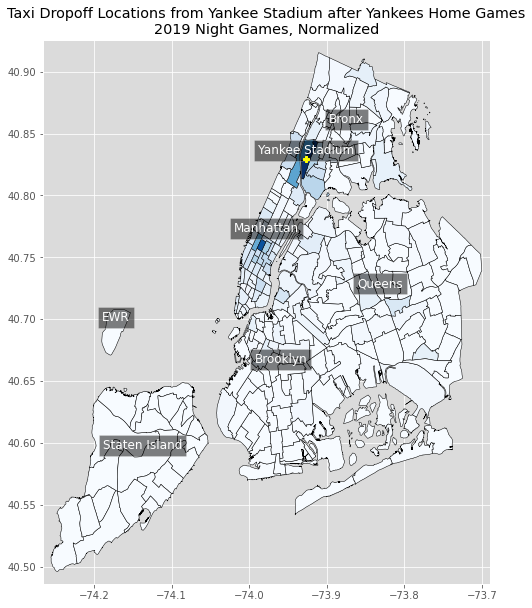

In [449]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Taxi Dropoff Locations from Yankee Stadium after Yankees Home Games\n2019 Night Games, Normalized")

draw_zone_map(ax, sf, location = (-73.9262, 40.8296), heat = HeatmapTrained1, heatcolor="Blues")
ax.plot(-73.9262, 40.8296, zorder = 3)
plt.savefig('YanksNormalized.jpg', bbox = 'tight')
plt.show()

In [382]:
#Mets Model


#SQL Database
#['index', 'VendorID', 'passenger_count', 'trip_distance', 'RatecodeID', 'store_and_fwd_flag', 'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount', 'total_amount', 'congestion_surcharge', 'pickup_datetime', 'dropoff_datetime']
#yanks query
df_mets_model = pd.read_sql_query('SELECT PULocationID, DOLocationID, pickup_datetime, dropoff_datetime, passenger_count, \
                                trip_distance, RatecodeID, payment_type, fare_amount, tip_amount \
                                FROM table_record \
                                WHERE PULocationID = 93 OR PULocationID = 253', nyc_database)

In [383]:
df_mets_model['pickup_datetime'] = pd.to_datetime(df_yanks['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
df_mets_model['dropoff_datetime'] = pd.to_datetime(df_yanks['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df_mets_model

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,RatecodeID,payment_type,fare_amount,tip_amount
0,93,231,2019-08-14 01:25:08,2019-08-14 01:45:54,2.0,10.87,2.0,1.0,52.00,11.06
1,93,186,2019-08-14 01:53:58,2019-08-14 01:57:59,1.0,8.89,2.0,1.0,52.00,2.00
2,93,234,2019-08-14 02:24:06,2019-08-14 02:47:39,2.0,8.50,2.0,1.0,52.00,12.25
3,93,93,2019-08-14 03:39:59,2019-08-14 03:52:44,1.0,0.04,5.0,1.0,62.00,12.46
4,93,211,2019-08-14 05:09:38,2019-08-14 05:18:16,2.0,12.16,2.0,1.0,52.00,10.00
...,...,...,...,...,...,...,...,...,...,...
40984,253,55,2019-07-29 12:24:35,2019-07-29 12:44:17,NaN,21.49,NaN,NaN,64.18,0.00
40985,93,93,2019-07-29 12:47:20,2019-07-29 12:59:24,NaN,0.68,NaN,NaN,22.45,0.00
40986,93,116,2019-07-29 12:58:38,2019-07-29 13:27:12,NaN,13.04,NaN,NaN,39.28,0.00
40987,93,28,2019-07-29 13:47:17,2019-07-29 13:59:09,NaN,4.84,NaN,NaN,20.65,0.00


In [384]:
df_mets_model['passenger_count']= df_mets_model['passenger_count'].fillna(1)
df_mets_model['RatecodeID']= df_mets_model['RatecodeID'].fillna(6)
df_mets_model['payment_type']= df_mets_model['payment_type'].fillna(5)

RateCodeDummies = pd.get_dummies(df_mets_model['RatecodeID'], prefix = 'RateCode')
PaymentCodeDummies = pd.get_dummies(df_mets_model['payment_type'], prefix = 'payment_type')

df_metstrain = pd.concat([df_mets_model, RateCodeDummies, PaymentCodeDummies], axis = 1)
df_metstrain = df_metstrain.drop(['RatecodeID', 'payment_type'], axis = 1)

df_metstrain['Longitude'] = df_metstrain['DOLocationID'].map(longitude_dict)
df_metstrain['Latitude'] = df_metstrain['DOLocationID'].map(latitude_dict)

df_metstrain = df_metstrain.dropna()

df_metstrain

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_5.0,RateCode_6.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,93,231,2019-08-14 01:25:08,2019-08-14 01:45:54,2.0,10.87,52.00,11.06,0,1,...,0,0,0,1,0,0,0,0,-74.007264,40.718576
1,93,186,2019-08-14 01:53:58,2019-08-14 01:57:59,1.0,8.89,52.00,2.00,0,1,...,0,0,0,1,0,0,0,0,-73.992434,40.748496
2,93,234,2019-08-14 02:24:06,2019-08-14 02:47:39,2.0,8.50,52.00,12.25,0,1,...,0,0,0,1,0,0,0,0,-73.990457,40.740237
3,93,93,2019-08-14 03:39:59,2019-08-14 03:52:44,1.0,0.04,62.00,12.46,0,0,...,1,0,0,1,0,0,0,0,-73.839178,40.739206
4,93,211,2019-08-14 05:09:38,2019-08-14 05:18:16,2.0,12.16,52.00,10.00,0,1,...,0,0,0,1,0,0,0,0,-74.001082,40.723716
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40984,253,55,2019-07-29 12:24:35,2019-07-29 12:44:17,1.0,21.49,64.18,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.986212,40.577087
40985,93,93,2019-07-29 12:47:20,2019-07-29 12:59:24,1.0,0.68,22.45,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.839178,40.739206
40986,93,116,2019-07-29 12:58:38,2019-07-29 13:27:12,1.0,13.04,39.28,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.949098,40.827644
40987,93,28,2019-07-29 13:47:17,2019-07-29 13:59:09,1.0,4.84,20.65,0.00,0,0,...,0,1,0,0,0,0,0,1,-73.808326,40.710741


In [385]:
df_metstrain.describe()

,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,RateCode_3.0,RateCode_4.0,RateCode_5.0,RateCode_6.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
count,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000,39728.000000
mean,97.405961,147.207511,1.538059,9.244468,39.402545,6.099056,0.476339,0.449809,0.002316,0.000604,0.057667,0.013240,0.000025,0.723721,0.249245,0.010522,0.003297,0.013215,-73.936389,40.745800
std,26.183171,69.805571,1.151023,4.377285,18.142481,5.697624,0.499446,0.497481,0.048067,0.024571,0.233116,0.114303,0.005017,0.447162,0.432581,0.102035,0.057329,0.114195,0.066748,0.040738
min,93.000000,1.000000,0.000000,-23.050000,-70.480000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-74.230644,40.527316
25%,93.000000,93.000000,1.000000,7.100000,27.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-73.984196,40.727954
50%,93.000000,144.000000,1.000000,9.910000,50.000000,5.460000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-73.965522,40.751637
75%,93.000000,223.000000,2.000000,11.730000,52.000000,11.700000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-73.884643,40.766952
max,253.000000,263.000000,9.000000,75.700000,600.000000,95.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,-73.714486,40.900079


In [406]:
df_metsaway = pd.DataFrame(columns = df_metstrain.columns)

for date in MetsAwayGamesTup:
    gamestart = datetime.timedelta(hours = 20)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_metstrain['pickup_datetime'] > date + gamestart) & (df_metstrain['pickup_datetime'] < date + gameend)

    df_metsaway = df_metsaway.append(df_metstrain[mask], ignore_index=True)
    
df_metsaway.describe()

,passenger_count,trip_distance,fare_amount,tip_amount,Longitude,Latitude
count,2210.000000,2210.000000,2210.000000,2210.000000,2210.000000,2210.000000
mean,1.515837,9.245986,35.671290,5.659240,-73.931514,40.742841
std,1.114931,4.679681,16.424707,5.578903,0.067266,0.041156
min,0.000000,-23.050000,-3.500000,0.000000,-74.171533,40.577087
25%,1.000000,5.872500,23.342500,0.000000,-73.984196,40.722703
50%,1.000000,10.020000,36.500000,5.000000,-73.957289,40.749124
75%,2.000000,12.050000,52.000000,10.000000,-73.873440,40.766952
max,6.000000,35.200000,125.000000,95.000000,-73.714486,40.900079


In [405]:
df_metshome = pd.DataFrame(columns = df_metstrain.columns)

for date in MetsHomeGamesTup:
    gamestart = datetime.timedelta(hours = 20)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_metstrain['pickup_datetime'] > date + gamestart) & (df_metstrain['pickup_datetime'] < date + gameend)

    df_metshome = df_metshome.append(df_metstrain[mask], ignore_index=True)
df_metshome

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,RateCode_1.0,RateCode_2.0,...,RateCode_5.0,RateCode_6.0,RateCode_99.0,payment_type_1.0,payment_type_2.0,payment_type_3.0,payment_type_4.0,payment_type_5.0,Longitude,Latitude
0,93,140,2019-04-09 21:33:53,2019-04-09 21:39:25,1.0,13.26,52.0,12.28,0,1,...,0,0,0,1,0,0,0,0,-73.954728,40.765305
1,93,211,2019-04-09 21:03:04,2019-04-09 21:04:03,1.0,10.60,52.0,7.50,0,1,...,0,0,0,1,0,0,0,0,-74.001082,40.723716
2,93,148,2019-04-09 21:47:20,2019-04-09 22:28:25,1.0,10.20,52.0,10.00,0,1,...,0,0,0,1,0,0,0,0,-73.990664,40.719102
3,93,74,2019-04-09 22:49:43,2019-04-09 22:57:53,2.0,10.67,52.0,11.78,0,1,...,0,0,0,1,0,0,0,0,-73.937410,40.805613
4,93,229,2019-04-09 22:05:27,2019-04-09 22:11:34,4.0,10.46,65.0,0.00,0,0,...,1,0,0,0,1,0,0,0,-73.964997,40.756574
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
811,93,148,2019-09-25 23:41:17,2019-09-26 00:02:40,1.0,11.35,52.0,12.28,0,1,...,0,0,0,1,0,0,0,0,-73.990664,40.719102
812,93,92,2019-09-25 21:22:00,2019-09-25 21:39:00,1.0,2.57,14.5,0.00,1,0,...,0,0,0,0,1,0,0,0,-73.827416,40.764348
813,93,166,2019-09-27 23:04:32,2019-09-27 23:06:14,1.0,10.70,52.0,0.00,0,1,...,0,0,0,1,0,0,0,0,-73.961604,40.809621
814,93,239,2019-09-28 21:28:53,2019-09-28 21:35:30,2.0,11.41,52.0,0.00,0,1,...,0,0,0,0,1,0,0,0,-73.978732,40.784025


In [388]:
df_metsaway_model = df_metsaway.drop(columns = ['PULocationID',	'DOLocationID',	'pickup_datetime','dropoff_datetime'], axis = 1)
df_metshome_model = df_metshome.drop(columns = ['PULocationID',	'DOLocationID',	'pickup_datetime','dropoff_datetime'], axis = 1)

In [399]:


from sklearn import preprocessing
metsNormalizer = preprocessing.Normalizer().fit(df_metsaway_model)

metsNormTrain = metsNormalizer.transform(df_metsaway_model)
metsNormTest = metsNormalizer.transform(df_metshome_model)

from sklearn.svm import OneClassSVM

SVM_model = OneClassSVM(kernel = 'linear', gamma='scale').fit(metsNormTrain)
df_metshome['Predict'] = SVM_model.predict(metsNormTest)
df_MetTraffic = df_metshome[df_metshome['Predict'] == -1]
SVM_model.coef_


array([[ 1.81842425e+01,  8.82542719e+01,  4.01852614e+02,
         6.37336531e+01,  6.09162702e+00,  4.69379329e+00,
         3.26662199e-02,  0.00000000e+00,  8.47949724e-01,
         7.71066857e-02,  0.00000000e+00,  7.22712902e+00,
         4.14638545e+00,  2.50513135e-01,  4.20086517e-02,
         7.71066857e-02, -8.68003383e+02,  4.78499367e+02]])

In [400]:
HeatmapTrained3, HeatmapTrained4 = HeatMaps(df_MetTraffic, MetsHomeGamesTup, MetsHomeGamesTup, startmodifier = datetime.timedelta(hours = 20), endmodifier = datetime.timedelta(hours = 24))
print(HeatmapTrained3, '\n', YanksHomeHeatMap)

{4: 1, 7: 10, 10: 1, 13: 3, 15: 1, 23: 1, 24: 2, 25: 1, 28: 4, 41: 3, 42: 2, 43: 6, 45: 1, 48: 6, 50: 5, 53: 4, 56: 13, 68: 1, 70: 15, 71: 1, 74: 2, 75: 1, 79: 5, 80: 1, 81: 2, 82: 3, 83: 1, 86: 1, 87: 3, 89: 1, 90: 3, 92: 12, 93: 28, 95: 20, 96: 1, 98: 2, 100: 4, 107: 1, 113: 2, 114: 1, 116: 3, 121: 3, 125: 2, 127: 1, 129: 11, 130: 1, 131: 1, 132: 15, 134: 4, 135: 1, 137: 4, 138: 23, 140: 8, 141: 3, 142: 5, 143: 2, 144: 1, 146: 1, 148: 8, 151: 4, 158: 1, 160: 1, 161: 9, 162: 8, 163: 4, 164: 15, 166: 7, 170: 12, 171: 2, 173: 11, 176: 1, 179: 5, 181: 1, 186: 3, 188: 1, 192: 2, 194: 2, 196: 3, 197: 2, 202: 1, 205: 1, 207: 1, 209: 2, 210: 1, 211: 2, 219: 1, 223: 8, 224: 1, 226: 3, 228: 1, 229: 4, 230: 17, 231: 2, 232: 2, 233: 4, 234: 6, 236: 5, 237: 5, 238: 1, 239: 8, 246: 4, 249: 2, 252: 2, 253: 2, 257: 1, 260: 2, 262: 6, 263: 3} 
 {3: 1, 4: 13, 7: 38, 9: 3, 10: 1, 13: 16, 14: 5, 15: 1, 16: 3, 17: 3, 18: 20, 19: 1, 20: 15, 24: 17, 25: 3, 28: 22, 29: 1, 31: 3, 32: 4, 33: 12, 35: 1, 36: 4,

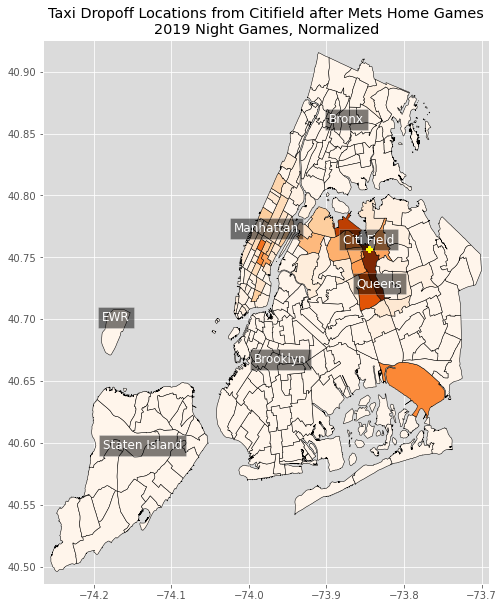

In [448]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 10))
ax = plt.subplot(1, 1, 1)
ax.set_title("Taxi Dropoff Locations from Citifield after Mets Home Games\n2019 Night Games, Normalized")

draw_zone_map(ax, sf, location = (-73.8458, 40.7571), heat = HeatmapTrained3, heatcolor='Oranges', pointtext = 'Citi Field')
ax.plot(-73.9262, 40.8296, zorder = 3)
plt.savefig('MetsNormalized.jpg')
plt.show()

In [464]:
def top_n(d, n):
  dct = defaultdict(list)
  total = 0 
  for k, v in d.items():
    dct[v].append(k)
    total = total + v      
  return sorted(dct.items())[-n:][::-1]

top_n(HeatmapTrained3, 5)

[(28, [93]), (23, [138]), (20, [95]), (17, [230]), (15, [70, 132, 164])]

*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n*** TRASH CODE ****** \n



In [392]:
df_yankshome = pd.DataFrame(columns = df_168.columns)

for date in YanksHomeGamesTup:
    gamestart = datetime.timedelta(hours = 20)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_yanks['pickup_datetime'] > date + gamestart) & (df_yanks['pickup_datetime'] < date + gameend)

    df_yankshome = df_yankshome.append(df_yanks[mask], ignore_index=True)

df_yankshome

NameError: name 'df_168' is not defined

In [130]:
yanksHomeHeatMap = df_yankshome[['DOLocationID', 'PULocationID']].groupby('DOLocationID').count()
yanksHomeDict = yanksHomeHeatMap.T.to_dict('records')
yanksHomeDict = yanksHomeDict[0]
yanksHomeDict[247] = 0
yanksHomeDict[119] = 0

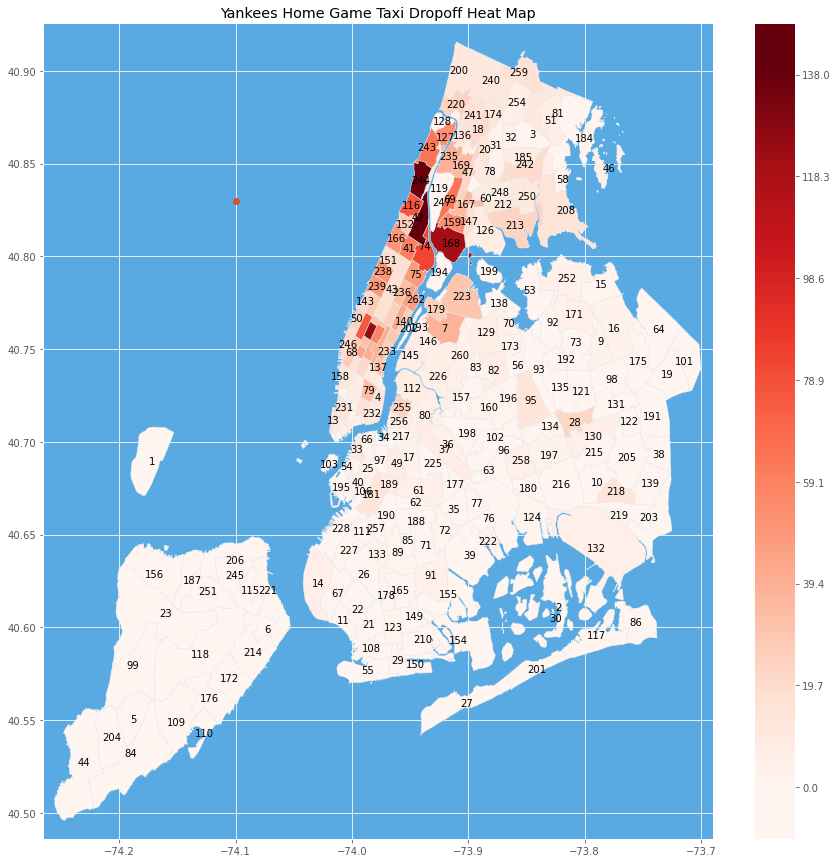

In [140]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,15))
ax = plt.subplot(1, 1, 1)
ax.set_title("Yankees Home Game Taxi Dropoff Heat Map")

draw_zone_map(ax, sf, heat = yanksHomeDict)
ax.plot(-73.9262, 40.8296, zorder = 3)
plt.show()

In [132]:
df_yanksaway = pd.DataFrame(columns = df_yanks.columns)

for date in YanksAwayGamesTup:
    gamestart = datetime.timedelta(hours = 21)
    gameend = datetime.timedelta(hours = 24)

    mask = (df_yanks['pickup_datetime'] > date + gamestart) & (df_yanks['pickup_datetime'] < date + gameend)

    df_yanksaway = df_yanksaway.append(df_yanks[mask], ignore_index=True)

df_yanksaway

,PULocationID,DOLocationID,pickup_datetime,dropoff_datetime
0,247,41,2019-04-06 21:40:56,2019-04-06 21:58:22
1,247,179,2019-04-06 22:01:59,2019-04-06 22:13:53
2,119,69,2019-04-06 22:06:41,2019-04-06 22:17:51
3,247,233,2019-04-06 22:33:38,2019-04-06 22:51:22
4,119,75,2019-04-06 23:50:59,2019-04-07 00:02:34
...,...,...,...,...
826,247,241,2019-09-28 23:59:36,2019-09-29 00:10:17
827,247,51,2019-09-28 23:49:06,2019-09-29 00:23:39
828,247,42,2019-09-28 23:37:04,2019-09-28 23:38:54
829,247,244,2019-09-28 23:59:21,2019-09-29 00:11:22


In [133]:
yanksAwayHeatMap = df_yanksaway[['DOLocationID', 'PULocationID']].groupby('DOLocationID').count()
yanksAwayDict = yanksAwayHeatMap.T.to_dict('records')
yanksAwayDict = yanksAwayDict[0]
yanksAwayDict[168] = 0

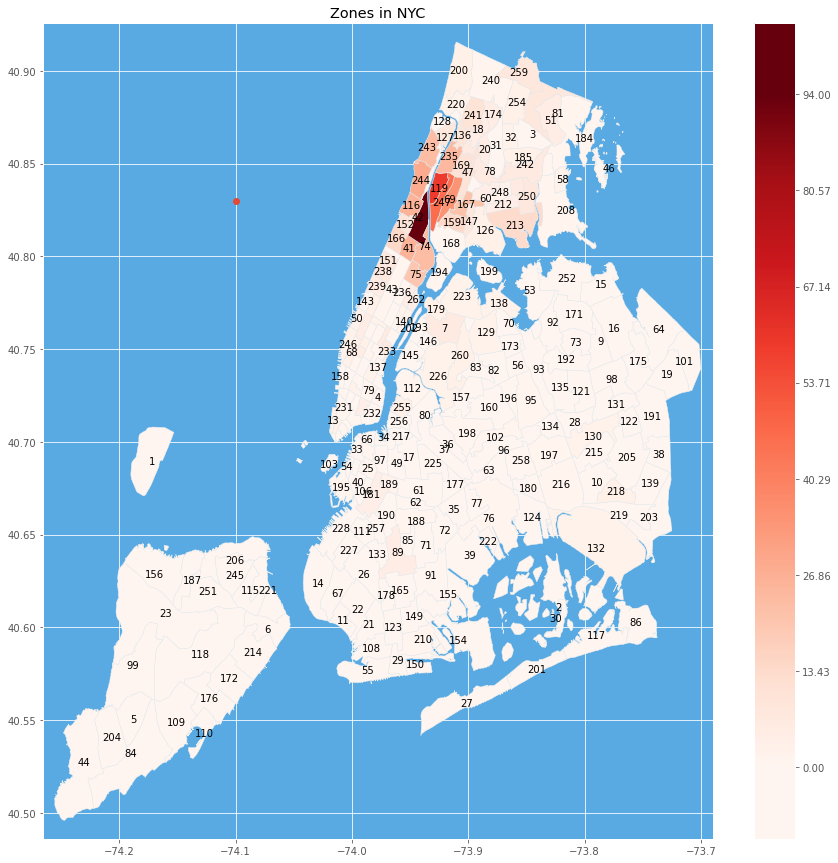

In [134]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,15))
ax = plt.subplot(1, 1, 1)
ax.set_title("Zones in NYC")

draw_zone_map(ax, sf, heat = yanksAwayDict)
ax.plot(-73.9262, 40.8296, zorder = 3)
plt.show()

In [32]:
df_yanks = pd.read_sql_query('SELECT pickup_datetime, dropoff_datetime, passenger_count, trip_distance, \
                        PULocationID, DOLocationID, payment_type \
                        fare_amount, extra, tip_amount, tolls_amount, total_amount \
                        FROM table_record \
                        WHERE PULocationID = 168 \
                        AND pickup_datetime > 2019-04-01 20:00:00 \
                        AND pickup_datetime < 2019-04-02 00:00:00 \
                        ', nyc_database)

In [33]:
df_yanks

,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,PULocationID,DOLocationID,fare_amount,extra,tip_amount,tolls_amount,total_amount


In [233]:
t = tuple(['135','135135','1355'])
query = "select name from studens where id IN {}".format(t)
query

"select name from studens where id IN ('135', '135135', '1355')"

NameError: name 'df_pu' is not defined

In [23]:
df_pu = pd.read_sql_query('SELECT PULocationID AS LocationID, count(*) AS PUcount \
                        FROM table_record \
                        GROUP BY PULocationID', nyc_database)
df_do = pd.read_sql_query('SELECT DOLocationID AS LocationID, count(*) AS DOcount \
                        FROM table_record \
                        GROUP BY DOLocationID', nyc_database)

ModuleNotFoundError: No module named 'flask_sqlalchemy'